In [3]:
import os
from os import path
import pandas as pd
import seaborn as sns
from matplotlib import pyplot as plt
import tqdm
import numpy as np
sns.set()

In [4]:
class EyeTrackingStudy:
    def __init__(self, data_path: str = "data"):
        self.data_path = data_path
        self.gazes = None
        self.pupils = None
        
    def is_ready(self):
        return self.gazes != None
    
    def filter_dataframe(self, df, confidence_th:float=0.8):
        return df[df["confidence">confidence_th]]
    
    def load_data(self, filtering:bool = False ):
        pg = tqdm.tqdm(os.listdir(self.data_path))
        for sub in pg:
            if not sub.startswith("sub"):
                continue
            number = int(sub.replace("sub", ""))
            for snap in os.listdir(path.join(self.data_path, sub)):
                if not snap.isnumeric(): continue
                current_snapshot = path.join(self.data_path, sub, snap)
                info = path.join(current_snapshot, "export_info.csv")
                gaze = path.join(current_snapshot, "gaze_positions.csv")
                pupil = path.join(current_snapshot, "pupil_positions.csv")
                
                gdf = pd.read_csv(gaze)
                if filtering: gdf = self.filter_dataframe(gdf)

                gdf.insert(0, "subject", number)

                if self.gazes is None:
                    self.gazes = gdf
                else:
                    self.gazes = pd.concat((self.gazes, gdf))
                pg.set_description("Loading gaze data of subject {}".format(number))
                
                pdf = pd.read_csv(pupil)
                if filtering: pdf = self.filter_dataframe(pdf)

                pdf.insert(0, "subject", number)

                if self.pupils is None:
                    self.pupils = pdf
                else:
                    self.pupils = pd.concat((self.pupils, pdf))
                pg.set_description("Loading pupil data of subject {}".format(number))

In [8]:
et = EyeTrackingStudy()
et.load_data()
et.gazes.sample(5)

Loading pupil data of subject 13: 100%|██████████| 33/33 [00:46<00:00,  1.42s/it]


,subject,gaze_timestamp,world_index,confidence,norm_pos_x,norm_pos_y,base_data,gaze_point_3d_x,gaze_point_3d_y,gaze_point_3d_z,...,eye_center0_3d_z,gaze_normal0_x,gaze_normal0_y,gaze_normal0_z,eye_center1_3d_x,eye_center1_3d_y,eye_center1_3d_z,gaze_normal1_x,gaze_normal1_y,gaze_normal1_z
31715,32,-758780.167460,213,0.980216,0.392234,0.988844,-758780.1727700001-0 -758780.162151-1,-65.323642,-156.054829,301.116678,...,-17.979756,-0.239192,-0.420026,0.875423,-39.204405,15.748257,-17.712184,-0.073694,-0.505478,0.859687
9552,11,447815.752043,1325,0.220547,0.312518,1.014179,447815.752043-1,-56.677839,-86.344028,149.886822,...,NaN,NaN,NaN,NaN,-21.013542,-2.500820,24.935346,-0.230623,-0.542172,0.807999
36300,2,574513.840485,510,0.851420,0.344519,0.179505,574513.832745-0 574513.848225-1,231.686983,-238.826878,-815.670030,...,34.443540,-0.228086,-0.293325,0.928406,-25.432620,-17.172958,-31.234875,-0.217636,0.732768,0.644736
1977,7,361395.565040,285,0.592733,2.467739,-6.789059,361395.56503999996-1,-27.829110,-60.765129,27.544696,...,NaN,NaN,NaN,NaN,-54.285654,27.267179,-57.794692,0.210928,-0.701849,0.680380
5910,31,-759700.242636,60,0.964972,0.631074,0.888935,-759700.237957-0 -759700.247315-1,26.728299,-55.039756,138.761443,...,-26.976524,0.005737,-0.372129,0.928163,-36.989091,12.791310,-48.512922,0.307870,-0.341840,0.887897


In [9]:
sns.relplot(
    x="norm_pos_x",
    y="norm_pos_y",
    col="subject",
    col_wrap=3,
    data=et.gazes
)

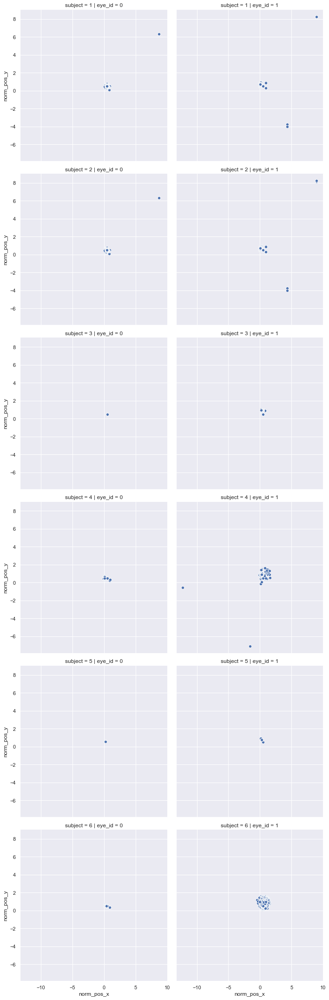

In [14]:
sns.relplot(
    x="norm_pos_x",
    y="norm_pos_y",
    col="eye_id",
    row="subject",
    data=et.pupils,
)

In [15]:
import visdom

In [16]:
vis = visdom.Visdom()

Setting up a new session...


In [28]:
vis.scatter()

'window_3875dc18a42d2c'

In [33]:
pos = et.gazes[et.gazes["confidence"]>0.8] # filtering
pos = np.array(pos[["norm_pos_x", "norm_pos_y"]])

In [20]:
et.gazes[et.gazes["subject"] == 1]

AttributeError: 'DataFrame' object has no attribute 'to_numpy_array'

In [22]:
pd.to_datetime(et.gazes["gaze_timestamp"])

0       1969-12-31 23:59:59.999241040
1       1969-12-31 23:59:59.999241040
2       1969-12-31 23:59:59.999241040
3       1969-12-31 23:59:59.999241040
4       1969-12-31 23:59:59.999241040
                     ...             
27488   1970-01-01 00:00:00.000449917
27489   1970-01-01 00:00:00.000449917
27490   1970-01-01 00:00:00.000449917
27491   1970-01-01 00:00:00.000449917
27492   1970-01-01 00:00:00.000449917
Name: gaze_timestamp, Length: 1146594, dtype: datetime64[ns]

In [27]:
et.gazes.info(memory_usage='deep')

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1146594 entries, 0 to 27492
Data columns (total 22 columns):
 #   Column            Non-Null Count    Dtype  
---  ------            --------------    -----  
 0   subject           1146594 non-null  int64  
 1   gaze_timestamp    1146594 non-null  float64
 2   world_index       1146594 non-null  int64  
 3   confidence        1146594 non-null  float64
 4   norm_pos_x        1146594 non-null  float64
 5   norm_pos_y        1146594 non-null  float64
 6   base_data         1146594 non-null  object 
 7   gaze_point_3d_x   1146594 non-null  float64
 8   gaze_point_3d_y   1146594 non-null  float64
 9   gaze_point_3d_z   1146594 non-null  float64
 10  eye_center0_3d_x  813796 non-null   float64
 11  eye_center0_3d_y  813796 non-null   float64
 12  eye_center0_3d_z  813796 non-null   float64
 13  gaze_normal0_x    813796 non-null   float64
 14  gaze_normal0_y    813796 non-null   float64
 15  gaze_normal0_z    813796 non-null   float64
 16  ey

In [28]:
def compress(df, verbose:bool=True):
    numerics = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']
    start_mem = df.memory_usage().sum() / 1024**2    
    for col in df.columns:
        col_type = df[col].dtypes
        if col_type in numerics:
            c_min = df[col].min()
            c_max = df[col].max()
            if str(col_type)[:3] == 'int':
                if c_min > np.iinfo(np.int8).min and c_max < np.iinfo(np.int8).max:
                    df[col] = df[col].astype(np.int8)
                elif c_min > np.iinfo(np.int16).min and c_max < np.iinfo(np.int16).max:
                    df[col] = df[col].astype(np.int16)
                elif c_min > np.iinfo(np.int32).min and c_max < np.iinfo(np.int32).max:
                    df[col] = df[col].astype(np.int32)
                elif c_min > np.iinfo(np.int64).min and c_max < np.iinfo(np.int64).max:
                    df[col] = df[col].astype(np.int64)  
            else:
                if c_min > np.finfo(np.float16).min and c_max < np.finfo(np.float16).max:
                    df[col] = df[col].astype(np.float16)
                elif c_min > np.finfo(np.float32).min and c_max < np.finfo(np.float32).max:
                    df[col] = df[col].astype(np.float32)
                else:
                    df[col] = df[col].astype(np.float64)    
    end_mem = df.memory_usage().sum() / 1024**2
    if verbose: print('Mem. usage decreased to {:5.2f} Mb ({:.1f}% reduction)'.format(end_mem, 100 * (start_mem - end_mem) / start_mem))
    return df

In [29]:
compress(et.gazes).info(memory_usage='deep')

Mem. usage decreased to 111.08 Mb (53.9% reduction)
<class 'pandas.core.frame.DataFrame'>
Int64Index: 1146594 entries, 0 to 27492
Data columns (total 22 columns):
 #   Column            Non-Null Count    Dtype  
---  ------            --------------    -----  
 0   subject           1146594 non-null  int8   
 1   gaze_timestamp    1146594 non-null  float32
 2   world_index       1146594 non-null  int16  
 3   confidence        1146594 non-null  float16
 4   norm_pos_x        1146594 non-null  float16
 5   norm_pos_y        1146594 non-null  float16
 6   base_data         1146594 non-null  object 
 7   gaze_point_3d_x   1146594 non-null  float32
 8   gaze_point_3d_y   1146594 non-null  float32
 9   gaze_point_3d_z   1146594 non-null  float32
 10  eye_center0_3d_x  813796 non-null   float16
 11  eye_center0_3d_y  813796 non-null   float16
 12  eye_center0_3d_z  813796 non-null   float16
 13  gaze_normal0_x    813796 non-null   float16
 14  gaze_normal0_y    813796 non-null   float16
 15 

In [30]:
et.pupils.info(memory_usage="deep")

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1146719 entries, 0 to 27501
Data columns (total 35 columns):
 #   Column                     Non-Null Count    Dtype  
---  ------                     --------------    -----  
 0   subject                    1146719 non-null  int64  
 1   pupil_timestamp            1146719 non-null  float64
 2   world_index                1146719 non-null  int64  
 3   eye_id                     1146719 non-null  int64  
 4   confidence                 1146719 non-null  float64
 5   norm_pos_x                 1146719 non-null  float64
 6   norm_pos_y                 1146719 non-null  float64
 7   diameter                   1146719 non-null  float64
 8   method                     1146719 non-null  object 
 9   ellipse_center_x           1146719 non-null  float64
 10  ellipse_center_y           1146719 non-null  float64
 11  ellipse_axis_a             1146719 non-null  float64
 12  ellipse_axis_b             1146719 non-null  float64
 13  ellipse_angle 

In [31]:
compress(et.pupils).info(memory_usage='deep')

Mem. usage decreased to 107.17 Mb (66.0% reduction)
<class 'pandas.core.frame.DataFrame'>
Int64Index: 1146719 entries, 0 to 27501
Data columns (total 35 columns):
 #   Column                     Non-Null Count    Dtype  
---  ------                     --------------    -----  
 0   subject                    1146719 non-null  int8   
 1   pupil_timestamp            1146719 non-null  float32
 2   world_index                1146719 non-null  int16  
 3   eye_id                     1146719 non-null  int8   
 4   confidence                 1146719 non-null  float16
 5   norm_pos_x                 1146719 non-null  float32
 6   norm_pos_y                 1146719 non-null  float32
 7   diameter                   1146719 non-null  float32
 8   method                     1146719 non-null  object 
 9   ellipse_center_x           1146719 non-null  float32
 10  ellipse_center_y           1146719 non-null  float32
 11  ellipse_axis_a             1146719 non-null  float32
 12  ellipse_axis_b      

In [42]:
dataset_path = "dataset"

compressed_pupils = compress(et.pupils)
compressed_pupils.info(memory_usage="deep")
compressed_pupils.to_csv(path.join(dataset_path, "pupils.csv"))

Mem. usage decreased to 107.17 Mb (0.0% reduction)
<class 'pandas.core.frame.DataFrame'>
Int64Index: 1146719 entries, 0 to 27501
Data columns (total 35 columns):
 #   Column                     Non-Null Count    Dtype  
---  ------                     --------------    -----  
 0   subject                    1146719 non-null  int8   
 1   pupil_timestamp            1146719 non-null  float32
 2   world_index                1146719 non-null  int16  
 3   eye_id                     1146719 non-null  int8   
 4   confidence                 1146719 non-null  float16
 5   norm_pos_x                 1146719 non-null  float32
 6   norm_pos_y                 1146719 non-null  float32
 7   diameter                   1146719 non-null  float32
 8   method                     1146719 non-null  object 
 9   ellipse_center_x           1146719 non-null  float32
 10  ellipse_center_y           1146719 non-null  float32
 11  ellipse_axis_a             1146719 non-null  float32
 12  ellipse_axis_b       

In [40]:
et.gazes["subject"].nunique()

32

In [60]:
import eyetracking as eye02

In [61]:
ets = eye02.EyeTrackingStudy("dataset")

In [62]:
ets.load_data()

loading data from filtered dataset


AttributeError: can't set attribute